In [29]:
# Initial imports
import pandas as pd
import hvplot.pandas
from path import Path
import plotly.express as px
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import plotly.figure_factory as ff
from sklearn.cluster import AgglomerativeClustering
import holoviews as hv

In [35]:
# Load the crypto_data.csv dataset.
file_link = "collision_data_ml_auto.csv"
auto_coll_data_df = pd.read_csv(file_link)
auto_coll_data_df

,case_id,party_number,victim_number,accident_year,collision_time,day_of_week,weather_1,primary_coll_factor,type_of_collision,at_fault,...,road_cond_1,lighting,point_x,point_y,victim_age,severe_injury,safety_equip_used,victim_sex,victim_seating_postion,victim_ejected
0,90600867,1,1,2017,1955,7,A,A,B,N,...,H,C,-118.280930,34.009389,30,0,GM,M,3,0
1,90600867,1,2,2017,1955,7,A,A,B,N,...,H,C,-118.280930,34.009389,29,0,GM,M,1,0
2,8539423,1,1,2018,2350,6,A,A,C,Y,...,H,C,-118.394562,34.141647,21,0,GL,F,1,0
3,9002091,2,1,2019,630,2,A,A,D,N,...,H,A,-118.518204,34.041370,55,0,GM,M,1,0
4,90798337,2,1,2018,2011,6,A,A,B,N,...,H,D,-118.228332,33.825619,22,0,GL,F,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
172347,8292798,1,1,2017,1815,5,A,A,D,Y,...,H,A,-118.428810,34.221670,53,0,GL,M,1,0
172348,8626600,1,1,2018,2200,4,A,A,D,Y,...,C,C,-118.335121,34.010929,32,0,BL,M,1,0
172349,8799235,1,1,2018,815,5,A,A,B,Y,...,H,A,-118.244209,34.032078,31,0,GM,M,1,0
172350,90470136,2,1,2017,1010,6,A,A,C,N,...,H,A,-118.090101,34.072212,25,0,GL,F,1,0


In [36]:
auto_coll_data_df = auto_coll_data_df.drop(columns=["party_number", "victim_number", 
                            "accident_year", "vehicle_make", "point_x", 
                            "point_y", "stwd_vehicle_type", "oaf_1", 
                            "primary_coll_factor", "party_sex", "at_fault",
                           "victim_age", "victim_sex", "race"])
auto_coll_data_ml_df

NameError: name 'auto_coll_data_ml_df' is not defined

In [37]:
# Set index to CASE_ID.
auto_coll_data_df = auto_coll_data_df.set_index("case_id")
auto_coll_data_df.index.name = None
auto_coll_data_df

,collision_time,day_of_week,weather_1,type_of_collision,party_soberiety,move_pre_acc,vehicle_year,road_surface,road_cond_1,lighting,severe_injury,safety_equip_used,victim_seating_postion,victim_ejected
90600867,1955,7,A,B,C,B,2012,A,H,C,0,GM,3,0
90600867,1955,7,A,B,C,B,2012,A,H,C,0,GM,1,0
8539423,2350,6,A,C,A,B,2012,A,H,C,0,GL,1,0
9002091,630,2,A,D,A,B,2018,A,H,A,0,GM,1,0
90798337,2011,6,A,B,A,B,2013,A,H,D,0,GL,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8292798,1815,5,A,D,A,B,2012,A,H,A,0,GL,1,0
8626600,2200,4,A,D,G,B,2006,A,C,C,0,BL,1,0
8799235,815,5,A,B,A,J,2012,A,H,A,0,GM,1,0
90470136,1010,6,A,C,A,A,2013,A,H,A,0,GL,1,0


In [39]:
# Convert strings to numeric values
from sklearn.preprocessing import LabelEncoder
auto_coll_encoded = pd.get_dummies(auto_coll_data_df, columns=["weather_1", "type_of_collision", 
                                            "party_soberiety", "move_pre_acc", 
                                            "road_surface", "road_cond_1", 
                                            "lighting", "safety_equip_used"])
auto_coll_encoded.head()

,collision_time,day_of_week,vehicle_year,severe_injury,victim_seating_postion,victim_ejected,weather_1_A,weather_1_B,weather_1_C,weather_1_D,...,safety_equip_used_PQ,safety_equip_used_PR,safety_equip_used_PS,safety_equip_used_PT,safety_equip_used_PU,safety_equip_used_PV,safety_equip_used_PW,safety_equip_used_PY,safety_equip_used_QR,safety_equip_used_QY
90600867,1955,7,2012,0,3,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
90600867,1955,7,2012,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8539423,2350,6,2012,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9002091,630,2,2018,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
90798337,2011,6,2013,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [40]:
# Standardize the data with StandardScaler().
auto_coll_scaled = StandardScaler().fit_transform(auto_coll_encoded)
print(auto_coll_scaled)

[[ 1.06203445  1.51200784  0.32667002 ... -0.00340651 -0.00240876
  -0.00340651]
 [ 1.06203445  1.51200784  0.32667002 ... -0.00340651 -0.00240876
  -0.00340651]
 [ 1.77999658  1.00203515  0.32667002 ... -0.00340651 -0.00240876
  -0.00340651]
 ...
 [-1.0100588   0.49206246  0.32667002 ... -0.00340651 -0.00240876
  -0.00340651]
 [-0.6556218   1.00203515  0.4713493  ... -0.00340651 -0.00240876
  -0.00340651]
 [ 0.14413349 -1.54782831 -0.68608494 ... -0.00340651 -0.00240876
  -0.00340651]]


In [41]:
# Using PCA to reduce dimension to three principal components.
pca = PCA(n_components=3)
auto_coll_pca = pca.fit_transform(auto_coll_scaled)
auto_coll_pca

array([[ 0.80275686, -2.33535509,  2.49991546],
       [ 0.8526272 , -2.36284894,  2.5445021 ],
       [ 0.04816749, -1.08011507,  0.5883494 ],
       ...,
       [-0.93093176,  0.48307501,  0.23874937],
       [-1.03131814,  0.6597049 ,  0.4609286 ],
       [ 0.98331916, -1.73326038,  0.90720386]])

In [42]:
# Create a DataFrame with the three principal components.
pca_df = pd.DataFrame(
    data=auto_coll_pca, columns=["PC 1", "PC 2", "PC 3"], index=auto_coll_data_df.index)
pca_df

,PC 1,PC 2,PC 3
90600867,0.802757,-2.335355,2.499915
90600867,0.852627,-2.362849,2.544502
8539423,0.048167,-1.080115,0.588349
9002091,-0.829029,0.037867,-1.524800
90798337,0.530662,-1.528291,0.346300
...,...,...,...
8292798,-0.138098,-1.294800,-2.022232
8626600,2.344905,-3.536170,4.183289
8799235,-0.930932,0.483075,0.238749
90470136,-1.031318,0.659705,0.460929


In [43]:
pca.explained_variance_ratio_

array([0.01982437, 0.01758238, 0.01485692])

In [44]:
# Create an elbow curve to find the best value for K.
# Find the best value for K
inertia = []
k = list(range(1,11))

# Calculate the inertia for the range of K values
for i in k:
    km = KMeans(n_clusters=i, random_state=0)
    km.fit(pca_df)
    inertia.append(km.inertia_)
    
#Create the elbow curve
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", xticks=k, title="Elbow Curve")

:Curve   [k]   (inertia)

In [49]:
# Initialize the K-Means model.
model = KMeans(n_clusters=4, random_state=2)

# Fit the model
model.fit(pca_df)

# Predict clusters
predictions = model.predict(pca_df)

In [50]:
# Create a new DataFrame including predicted clusters and cryptocurrencies features.
# Concatentate the crypto_df and pcs_df DataFrames on the same columns.
clustered_df = pd.concat([auto_coll_data_df, pca_df], axis=1)
clustered_df
clustered_df.index.name = None


#  Add a new column, "Class" to the clustered_df DataFrame that holds the predictions.
clustered_df["Class"] = model.labels_

# Print the shape of the clustered_df
print(clustered_df.shape)
clustered_df.head(10)

(172352, 18)


,collision_time,day_of_week,weather_1,type_of_collision,party_soberiety,move_pre_acc,vehicle_year,road_surface,road_cond_1,lighting,severe_injury,safety_equip_used,victim_seating_postion,victim_ejected,PC 1,PC 2,PC 3,Class
90600867,1955,7,A,B,C,B,2012,A,H,C,0,GM,3,0,0.802757,-2.335355,2.499915,3
90600867,1955,7,A,B,C,B,2012,A,H,C,0,GM,1,0,0.852627,-2.362849,2.544502,3
8539423,2350,6,A,C,A,B,2012,A,H,C,0,GL,1,0,0.048167,-1.080115,0.588349,0
9002091,630,2,A,D,A,B,2018,A,H,A,0,GM,1,0,-0.829029,0.037867,-1.524800,0
90798337,2011,6,A,B,A,B,2013,A,H,D,0,GL,1,0,0.530662,-1.528291,0.346300,0
90798337,2011,6,A,B,A,B,2013,A,H,D,0,GM,3,0,-0.248332,-0.320020,0.996579,1
8486935,2203,1,A,D,A,B,2001,A,H,C,0,GM,6,0,-0.358409,-0.761206,-0.439194,0
8486935,2203,1,A,D,A,B,2001,A,H,C,0,GM,3,0,-0.283603,-0.802446,-0.372314,0
8751001,900,4,A,G,A,B,2015,A,H,A,0,GM,1,0,-0.908277,0.317790,-0.555132,0
8338805,1155,6,A,D,A,B,2012,A,H,A,0,GL,1,0,-0.053173,-1.305401,-2.016745,0


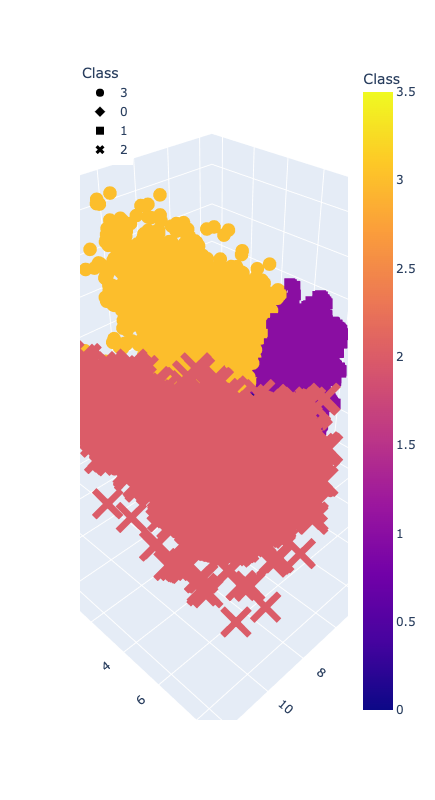

In [51]:
# Creating a 3D-Scatter with the PCA data and the clusters
fig = px.scatter_3d(clustered_df, x="PC 1", y="PC 2", z="PC 3",
                    color="Class", symbol="Class", hover_name='move_pre_acc', hover_data=["type_of_collision"], width=1200, height=800)
fig.update_layout(legend=dict(x=0, y=1))
fig.show()